In [318]:
from src.SensitivityAnalysis import load_data
import matplotlib.pyplot as plt
import pandas as pd
from src.SugarScape import SugarScape
from mesa import batch_run
import numpy as np
from tqdm import tqdm
from scipy import stats
import seaborn as sns


In [320]:
def calculate_directional_autocorrelation(grid, max_distance=None):
    """
    Calculate directional autocorrelation for a 2D grid.
    Parameters:
    grid (numpy.ndarray): A 2D numpy array representing the grid.
    max_distance (int, optional): The maximum distance to calculate
        autocorrelation. If None, it's set to half of the minimum dimension
        of the grid.

    Returns:
    tuple: A tuple containing five numpy arrays:
        - distances: The distances at which autocorrelation is calculated.
        - horizontal_autocorrelations: Autocorrelation values in the horizontal direction.
        - vertical_autocorrelations: Autocorrelation values in the vertical direction.
        - diagonal1_autocorrelations: Autocorrelation values in the top-left to bottom-right diagonal.
        - diagonal2_autocorrelations: Autocorrelation values in the top-right to bottom-left diagonal.
    """
    height, width = grid.shape
    if max_distance is None:
        max_distance = min(height, width) // 2

    mean = np.mean(grid)
    var = np.var(grid)
    # arrrays to store results
    horizontal_autocorrelations = []
    vertical_autocorrelations = []
    diagonal1_autocorrelations = [] 
    diagonal2_autocorrelations = []  
    distances = list(range(max_distance))

    for r in distances:
        #counters and sums
        horizontal_covariance_sum = 0
        vertical_covariance_sum = 0
        diagonal1_covariance_sum = 0
        diagonal2_covariance_sum = 0
        horizontal_count = 0
        vertical_count = 0
        diagonal1_count = 0
        diagonal2_count = 0

        for i in range(height):
            for j in range(width):
                if i + r < height:
                    #calculate vertical sum of covariance 
                    vertical_covariance_sum += (grid[i, j] - mean) * (grid[i+r, j] - mean)
                    vertical_count += 1
                if j + r < width:
                    #calculate horizontal sum of covariance
                    horizontal_covariance_sum += (grid[i, j] - mean) * (grid[i, j+r] - mean)
                    horizontal_count += 1
                if i + r < height and j + r < width:
                    #calculate diagonal sum of covariance from top left to bottom right
                    diagonal1_covariance_sum += (grid[i, j] - mean) * (grid[i+r, j+r] - mean)
                    diagonal1_count += 1
                if i + r < height and j - r >= 0:
                    #calculate diagonal sum of covariance from top right to bottom left
                    diagonal2_covariance_sum += (grid[i, j] - mean) * (grid[i+r, j-r] - mean)
                    diagonal2_count += 1

        if horizontal_count > 0:
            # calculate horizontal autocorrelation
            horizontal_autocorr = horizontal_covariance_sum / (horizontal_count * var)
            horizontal_autocorrelations.append(horizontal_autocorr)
        else:
            break

        if vertical_count > 0:
            # calculate vertical autocorrelation
            vertical_autocorr = vertical_covariance_sum / (vertical_count * var)
            vertical_autocorrelations.append(vertical_autocorr)
        else:
            break

        if diagonal1_count > 0:
            # calculate diagonal autocorrelation
            diagonal1_autocorr = diagonal1_covariance_sum / (diagonal1_count * var)
            diagonal1_autocorrelations.append(diagonal1_autocorr)

        if diagonal2_count > 0:
            # calculate diagonal autocorrelation
            diagonal2_autocorr = diagonal2_covariance_sum / (diagonal2_count * var)
            diagonal2_autocorrelations.append(diagonal2_autocorr)

    return (np.array(distances[:len(horizontal_autocorrelations)]),
            np.array(horizontal_autocorrelations),
            np.array(vertical_autocorrelations),
            np.array(diagonal1_autocorrelations),
            np.array(diagonal2_autocorrelations))

# distances, horizontal_autocorr, vertical_autocorr, diagonal1_autocorr, diagonal2_autocorr = calculate_directional_autocorrelation(resulting_df["average_spice_metabolism"][8])


In [321]:
def calculate_autocorrelation(grid, max_distance=None):
    """
    Calculate spatial autocorrelation for a 2D grid.
    
    Parameters:
    grid (numpy.ndarray): A 2D numpy array representing the grid.
    max_distance (int, optional): The maximum distance to calculate
        autocorrelation. If None, it's set to half of the minimum dimension
        of the grid.

    Returns:
    tuple: A tuple containing two numpy arrays:
        - distances: The distances at which autocorrelation is calculated.
        - autocorrelations: The corresponding autocorrelation values.
    """
    height, width = grid.shape
    if max_distance is None:
        max_distance = min(height, width) // 2

    mean = np.mean(grid)
    var = np.var(grid)
    autocorrelations = []
    distances = list(range(max_distance))

    for r in distances:
        covariance_sum = 0
        count = 0
        for i in range(height):
            for j in range(width):
                if i + r < height:
                    covariance_sum += (grid[i, j] - mean) * (grid[i+r, j] - mean)
                    count += 1
                if j + r < width:
                    covariance_sum += (grid[i, j] - mean) * (grid[i, j+r] - mean)
                    count += 1
        
        if count > 0:
            autocorr = covariance_sum / (count * var)
            autocorrelations.append(autocorr)
        else:
            break

    return np.array(distances[:len(autocorrelations)]), np.array(autocorrelations)


In [304]:
def segregation_experiments():
    """
    This function performs multiple simulations of the SugarScape model with
    various combinations of parameters

    The function calculates and stores various metrics for each simulation,
    including average spice metabolism maps and different types of autocorrelations.

    Returns:
    pd.DataFrame: A DataFrame containing the results of all experiments, with
    columns for each parameter combination and resulting metrics.
    """
    maps = ['uniform', 'split']
    tax_systems = [
        ("luxury", "progressive"),
    ]
    tax_rates = [0, 0.25, 0.4]
    replicates = 20
    max_steps = 350
    results_list = []

    # iterate through all combinations of parameters
    for map_scheme in maps:
        for tax_system in tax_systems:
            for tax_rate in tax_rates:
                # initialize lists to store results for each replicate
                avg, auto, dist = [], [], []
                horizontal_autocor, vertical_autocor = [], []
                diagonal1_autoco, diagonal2_autoco = [], []

                # run multiple replicates for each parameter combination
                for i in range(replicates):
                    # initialize and run the model
                    model = SugarScape(tax_rate=tax_rate, map_scheme=map_scheme, tax_scheme=tax_system[0],
                                       distributer_scheme=tax_system[1])
                    model.run_model(max_steps)

                    # calculate and store various metrics
                    average_spice_metabolism = model.get_average_spice_metabolism_map()
                    distance, autocorrelation = calculate_autocorrelation(average_spice_metabolism)
                    distances, horizontal_autocorr, vertical_autocorr, diagonal1_autocorr, diagonal2_autocorr = calculate_directional_autocorrelation(average_spice_metabolism)

                    #append results to respective lists
                    avg.append(average_spice_metabolism)
                    auto.append(autocorrelation)
                    dist.append(distance)
                    horizontal_autocor.append(horizontal_autocorr)
                    vertical_autocor.append(vertical_autocorr)
                    diagonal1_autoco.append(diagonal1_autocorr)
                    diagonal2_autoco.append(diagonal2_autocorr)

                # store results for this parameter combination
                results_list.append({
                    "map_scheme": map_scheme,
                    "tax_scheme": tax_system[0],
                    "distributer_scheme": tax_system[1],
                    "tax_rate": tax_rate,
                    "average_spice_metabolism": np.array(avg),
                    "autocorrelation": auto,
                    "distance": dist,
                    "horizontal_autocorr": np.array(horizontal_autocor),
                    "vertical_autocorr": np.array(vertical_autocor),
                    "diagonal1_autocorr": np.array(diagonal1_autoco),
                    "diagonal2_autocorr": np.array(diagonal2_autoco)
                })

    # convert results to a DataFrame
    final_results = pd.DataFrame(results_list)

    return final_results

In [305]:
resulting_df = segregation_experiments()

[[nan nan nan ...  6. nan nan]
 [nan nan nan ... nan nan  5.]
 [nan nan  6. ... nan  4. nan]
 ...
 [nan nan nan ...  3. nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]
[[nan nan nan ...  6. nan nan]
 [nan nan nan ... nan nan  5.]
 [nan  6.  6. ... nan  4.  5.]
 ...
 [nan nan  8. ...  3. nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]
[[ 6. nan nan ...  6. nan nan]
 [nan nan nan ... nan nan  5.]
 [ 2.  6.  6. ... nan  4.  5.]
 ...
 [nan nan  8. ...  3. nan nan]
 [nan  2. nan ... nan nan  9.]
 [nan nan nan ... nan nan nan]]
[[ 6.  6. nan ...  6.  4. nan]
 [nan nan nan ... nan  5.  5.]
 [ 2.  6.  6. ... nan  4.  5.]
 ...
 [ 2.  7.  8. ...  3. nan nan]
 [nan  2. nan ... nan nan  9.]
 [nan nan nan ... nan  9. nan]]
[[6.  6.  6.  ... 6.  4.  nan]
 [nan nan nan ... nan 5.  5. ]
 [2.  6.  6.  ... 6.  4.5 5. ]
 ...
 [2.  7.  8.  ... 3.  nan nan]
 [nan 2.  nan ... nan nan 9. ]
 [nan nan nan ... nan 9.  nan]]
[[6.  6.  6.  ... 6.  4.  nan]
 [4.  nan

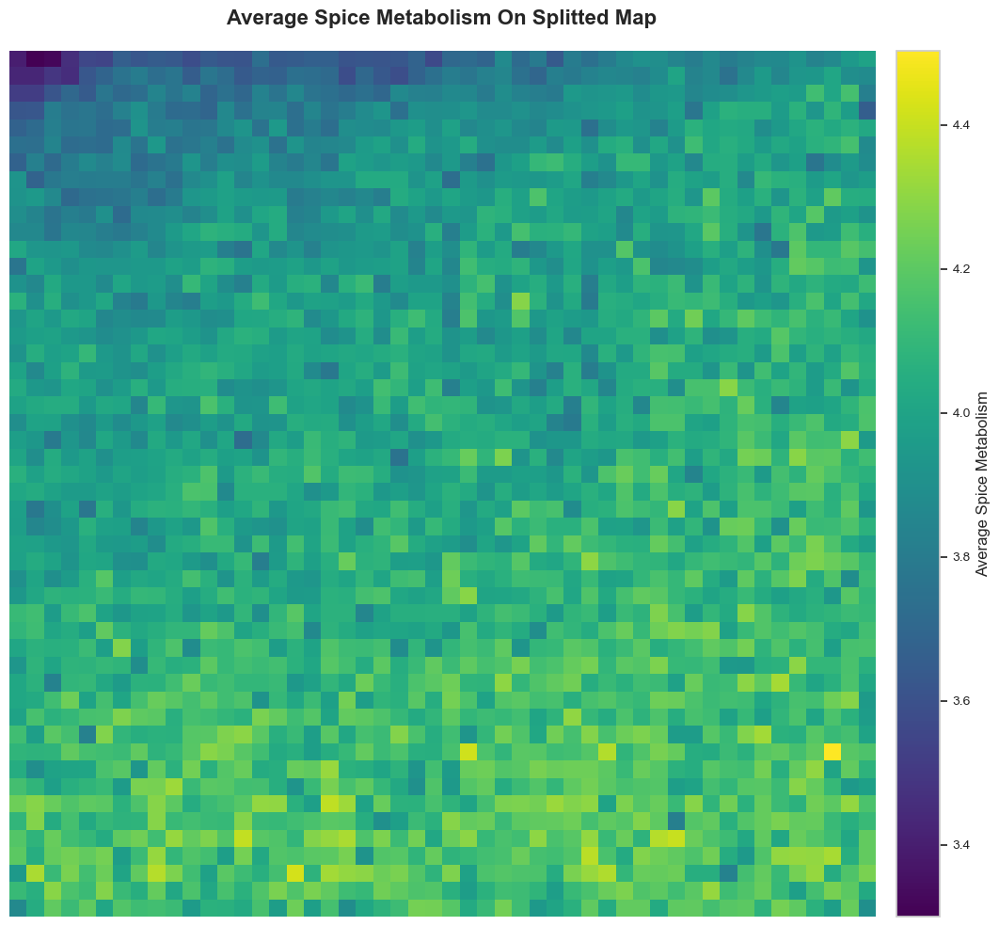

In [317]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12, 10))
sns.set_style("whitegrid")

im = plt.imshow(resulting_df["average_spice_metabolism"][2].mean(axis=0), cmap='viridis', interpolation='nearest')
cbar = plt.colorbar(im, label='Average Spice Metabolism', pad=0.02)
cbar.ax.tick_params(labelsize=10)
plt.title('Average Spice Metabolism On Splitted Map', fontsize=16, fontweight='bold', pad=20)
plt.axis('off')
plt.tight_layout()
plt.show()

In [161]:
def spatial_shannon_entropy(data):
    """
    This function computes the Shannon entropy of the spatial distribution
    of values in a 2D array. It flattens the 2D array, creates a histogram
    of the values, and then calculates the entropy based on the probabilities
    of each bin.

    Parameters:
    data (numpy.ndarray): A 2D numpy array containing the spatial data.
    Returns:
    float: The calculated Shannon entropy.
    """
    flat_data = data.flatten()
    hist, _ = np.histogram(flat_data, bins='auto')
    probabilities = hist / np.sum(hist)
    entropy = stats.entropy(probabilities)
    return entropy


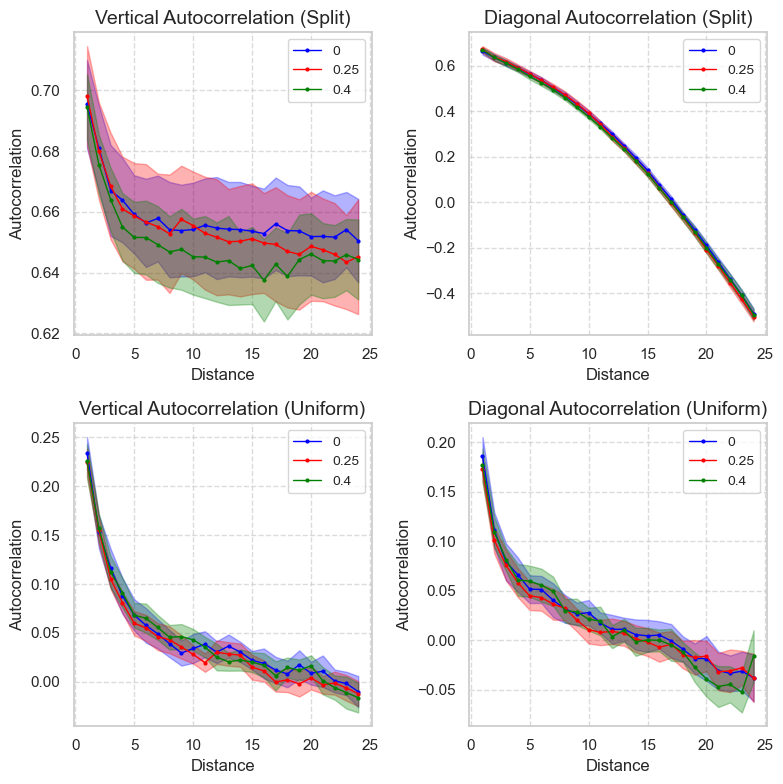


Statistical Comparison of Autocorrelations (3-5):

Vertical Autocorrelation:
Map 3 vs Map 4: Mean t-statistic = 0.2420, Mean p-value = 0.7673
Map 3 vs Map 5: Mean t-statistic = 0.8469, Mean p-value = 0.4245
Map 4 vs Map 5: Mean t-statistic = 0.5027, Mean p-value = 0.6153

Diagonal1 Autocorrelation:
Map 3 vs Map 4: Mean t-statistic = 0.5325, Mean p-value = 0.4917
Map 3 vs Map 5: Mean t-statistic = 0.9054, Mean p-value = 0.4220
Map 4 vs Map 5: Mean t-statistic = 0.3374, Mean p-value = 0.5524

Statistical Comparison of Autocorrelations (0-2):

Vertical Autocorrelation:
Map 0 vs Map 1: Mean t-statistic = 0.6370, Mean p-value = 0.5267
Map 0 vs Map 2: Mean t-statistic = 0.1148, Mean p-value = 0.5365
Map 1 vs Map 2: Mean t-statistic = -0.5842, Mean p-value = 0.4491

Diagonal1 Autocorrelation:
Map 0 vs Map 1: Mean t-statistic = 0.4749, Mean p-value = 0.6301
Map 0 vs Map 2: Mean t-statistic = 0.3007, Mean p-value = 0.5739
Map 1 vs Map 2: Mean t-statistic = -0.1647, Mean p-value = 0.4780


In [314]:
def compare_autocorrelations(df, map_indices_top, map_indices_bottom):
    """
    Compare and visualize autocorrelations for different map configurations.

    Parameters:
    df (pandas.DataFrame): DataFrame containing the autocorrelation data.
    map_indices_top (list): Indices for the top row of plots (typically split maps).
    map_indices_bottom (list): Indices for the bottom row of plots (typically uniform maps).

    Returns:
    None: The function displays plots and prints statistical comparisons.

    Note:
    The function assumes specific column names in the DataFrame for autocorrelations
    and distances. It also assumes that the map indices correspond to different tax rates.
    """
    fig, axs = plt.subplots(2, 2, figsize=(8, 8))
    directions = ['vertical', 'diagonal1']
    colors = ['blue', 'red', 'green', 'purple']
    taxes = [0, 0.25, 0.4]
    
    # plot autocorrelations
    for row, map_indices in enumerate([map_indices_top, map_indices_bottom]):
        for col, direction in enumerate(directions):
            ax = axs[row, col]
            
            for (i, map_idx), taxe in zip(enumerate(map_indices), taxes):
                # extract data and calculate statistics
                data = df.loc[map_idx, f'{direction}_autocorr']
                distances = df.loc[map_idx, 'distance']
                if isinstance(data[0], (list, np.ndarray)):
                    data = np.array(data)[:, 1:] 
                    mean = np.mean(data, axis=0)
                    std = np.std(data, axis=0)
                    ci_95 = 1.96 * std / np.sqrt(data.shape[0])
                else:
                    mean = np.array(data)[1:]  
                    ci_95 = np.zeros_like(mean)  
                
                distances = distances[0] if isinstance(distances[0], (list, np.ndarray)) else distances
                distances = distances[1:] 
                
                # plot mean and confidence interval
                ax.plot(distances, mean, '-o', label=f'{taxe}', color=colors[i], linewidth=1, markersize=2)
                ax.fill_between(distances, mean - ci_95, mean + ci_95, alpha=0.3, color=colors[i])
            
            ax.set_xlabel('Distance', fontsize=12)
            ax.set_ylabel('Autocorrelation', fontsize=12)
            map_type = "Split" if map_idx >= 3 else "Uniform"
            direction = 'diagonal' if direction == 'diagonal1' else direction
            ax.set_title(f'{direction.capitalize()} Autocorrelation ({map_type})', fontsize=14)
            ax.legend(fontsize=10, loc='upper right')
            ax.grid(True, linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    plt.show()

    #pPerform statistical comparisons
    for map_indices in [map_indices_top, map_indices_bottom]:
        print(f"\nStatistical Comparison of Autocorrelations ({map_indices[0]}-{map_indices[-1]}):")
        for direction in directions:
            print(f"\n{direction.capitalize()} Autocorrelation:")
            for i in range(len(map_indices)):
                for j in range(i+1, len(map_indices)):
                    map1_data = np.array(df.loc[map_indices[i], f'{direction}_autocorr'])
                    map2_data = np.array(df.loc[map_indices[j], f'{direction}_autocorr'])
                    map1 = map1_data[:, 1:] if map1_data.ndim > 1 else map1_data[1:]
                    map2 = map2_data[:, 1:] if map2_data.ndim > 1 else map2_data[1:]
                    if map1.ndim > 1 and map2.ndim > 1:
                        t_stat, p_value = stats.ttest_ind(map1, map2)
                        if isinstance(t_stat, np.ndarray):
                            t_stat_mean = np.mean(t_stat)
                            p_value_mean = np.mean(p_value)
                            print(f"Map {map_indices[i]} vs Map {map_indices[j]}: Mean t-statistic = {t_stat_mean:.4f}, Mean p-value = {p_value_mean:.4f}")
                        else:
                            print(f"Map {map_indices[i]} vs Map {map_indices[j]}: t-statistic = {t_stat:.4f}, p-value = {p_value:.4f}")
                    else:
                        print(f"Insufficient data")

In [322]:
for idx, (i, k, met, map_sc) in enumerate(zip(resulting_df["autocorrelation"], resulting_df["distance"], resulting_df["average_spice_metabolism"], resulting_df["map_scheme"])):
    entropy = spatial_shannon_entropy(met)  
    print(f"Grid {idx+1} Shannon entropy: {entropy:.2f}")

Grid 1 Shannon entropy: 4.17
Grid 2 Shannon entropy: 4.17
Grid 3 Shannon entropy: 4.17
Grid 4 Shannon entropy: 3.84
Grid 5 Shannon entropy: 3.85
Grid 6 Shannon entropy: 3.86
